In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

# Importing all necessary libraries.

In [2]:
import torch
import torch.nn as nn
import matplotlib.pyplot as plt
import os
import requests
import numpy as np
import tarfile
import time
from torchvision import transforms
from torchvision.transforms import RandomCrop, functional as TF
from torch.utils.data import DataLoader, random_split, Dataset
from PIL import Image
from pathlib import Path
import random
from IPython import display
from IPython.display import clear_output
from torchvision.models import vgg16, VGG16_Weights
import torch.nn.functional as F
from torch.nn.init import xavier_normal_, constant_
from tqdm import tqdm

# Defining Constants

In [3]:
IMG_HEIGHT, IMG_WIDTH = 256, 256
BATCH_SIZE = 4 
LEARNING_RATE = 2e-4
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
DEVICE

device(type='cuda')

# Downloading Dataset ( NYU Depth V2 )

In [4]:
!wget http://horatio.cs.nyu.edu/mit/silberman/nyu_depth_v2/nyu_depth_v2_labeled.mat

--2025-06-16 02:51:15--  http://horatio.cs.nyu.edu/mit/silberman/nyu_depth_v2/nyu_depth_v2_labeled.mat
Resolving horatio.cs.nyu.edu (horatio.cs.nyu.edu)... 216.165.22.17
Connecting to horatio.cs.nyu.edu (horatio.cs.nyu.edu)|216.165.22.17|:80... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://horatio.cs.nyu.edu/mit/silberman/nyu_depth_v2/nyu_depth_v2_labeled.mat [following]
--2025-06-16 02:51:15--  https://horatio.cs.nyu.edu/mit/silberman/nyu_depth_v2/nyu_depth_v2_labeled.mat
Connecting to horatio.cs.nyu.edu (horatio.cs.nyu.edu)|216.165.22.17|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2972037809 (2.8G)
Saving to: ‘nyu_depth_v2_labeled.mat’

nyu_depth_v2_labele 100%[===================>]   2.77G  37.0MB/s    in 71s     

2025-06-16 02:52:26 (40.0 MB/s) - ‘nyu_depth_v2_labeled.mat’ saved [2972037809/2972037809]



Processing data into readable form.

In [5]:
import h5py
import json

file = h5py.File("nyu_depth_v2_labeled.mat", "r")

print("Available datasets in the file:")
def print_structure(name, obj):
    if isinstance(obj, h5py.Dataset):
        pass
print_structure("", file)
file.visititems(print_structure)

target_datasets = ["images", "depths", "labels", "instances"]
datasets = {}

for key in target_datasets:
    if key in file and isinstance(file[key], h5py.Dataset):
        datasets[key] = file[key]
        print(f"Loading {key}: {file[key].shape}")
    else:
        print(f"Warning: {key} not found in file")

base_dir = "nyu_dataset"
for dataset_name in datasets.keys():
    os.makedirs(f"{base_dir}/{dataset_name}", exist_ok=True)

num_samples = len(datasets[list(datasets.keys())[0]])
print(f"Number of samples: {num_samples}")

for i in range(num_samples):

    for dataset_name, dataset in datasets.items():
        try:
            data = dataset[i]

            if dataset_name == "images":
                rgb = np.transpose(data, (2, 1, 0))
                rgb = (rgb / np.max(rgb) * 255).astype(np.uint8)
                rgb_img = Image.fromarray(rgb).resize((256, 256))
                rgb_img.save(f"{base_dir}/{dataset_name}/{i:04d}.png")

            elif dataset_name == "depths":
                depth = np.transpose(data, (1, 0))
                depth = (depth / np.max(depth) * 255).astype(np.uint8)
                depth_img = Image.fromarray(depth).resize((256, 256))
                depth_img.save(f"{base_dir}/{dataset_name}/{i:04d}.png")

            elif dataset_name == "labels":
                if len(data.shape) == 2:
                    labels = np.transpose(data, (1, 0))
                else:
                    labels = data

                if labels.dtype != np.uint8:
                    labels = labels.astype(np.uint8)

                label_img = Image.fromarray(labels).resize((256, 256), Image.NEAREST)  # Use nearest for labels
                label_img.save(f"{base_dir}/{dataset_name}/{i:04d}.png")

            elif dataset_name == "instances":
                if len(data.shape) == 2:
                    instances = np.transpose(data, (1, 0))
                else:
                    instances = data

                if instances.dtype != np.uint8:
                    if instances.max() > 0:
                        instances = (instances / instances.max() * 255).astype(np.uint8)
                    else:
                        instances = instances.astype(np.uint8)

                instance_img = Image.fromarray(instances).resize((256, 256), Image.NEAREST)
                instance_img.save(f"{base_dir}/{dataset_name}/{i:04d}.png")

            elif dataset_name in ["rawDepths", "rawRgb"]:
                pass

            else:
                pass

        except Exception as e:
            print(f"Error processing {dataset_name} sample {i}: {e}")
            continue

def get_dataset_description(name):
    descriptions = {
        "images": "RGB images",
        "depths": "Depth maps",
        "labels": "Semantic segmentation labels",
        "instances": "Instance segmentation masks"
    }
    return descriptions.get(name, "Unknown dataset")

dataset_info = {
    "num_samples": num_samples,
    "datasets": {}
}

for name, dataset in datasets.items():
    dataset_info["datasets"][name] = {
        "shape": list(dataset.shape),
        "dtype": str(dataset.dtype),
        "description": get_dataset_description(name)
    }

with open(f"{base_dir}/dataset_info.json", "w") as f:
    json.dump(dataset_info, f, indent=2)

print(f"Dataset extraction complete!")
print(f"Extracted {num_samples} samples")
print(f"Available datasets: {list(datasets.keys())}")
print(f"Files saved in: {base_dir}/")

file.close()


Available datasets in the file:
Loading images: (1449, 3, 640, 480)
Loading depths: (1449, 640, 480)
Loading labels: (1449, 640, 480)
Loading instances: (1449, 640, 480)
Number of samples: 1449
Dataset extraction complete!
Extracted 1449 samples
Available datasets: ['images', 'depths', 'labels', 'instances']
Files saved in: nyu_dataset/


# Defining Layers and Helper Functions

In [6]:
def conv(in_planes, out_planes, stride=1, batch_norm=False):
    if batch_norm:
        return nn.Sequential(
            nn.Conv2d(in_planes, out_planes, kernel_size=3, stride=stride, padding=1, bias=False),
            nn.InstanceNorm2d(out_planes, eps=1e-3, affine=True),
            nn.ReLU(inplace=True)
        )
    else:
        return nn.Sequential(
            nn.Conv2d(in_planes, out_planes, kernel_size=3, stride=stride, padding=1, bias=True),
            nn.ReLU(inplace=True)
        )


def deconv(in_planes, out_planes, batch_norm=False):
    if batch_norm:
        return nn.Sequential(
            nn.ConvTranspose2d(in_planes, out_planes, kernel_size=4, stride=2, padding=1, bias=True),
            nn.Conv2d(out_planes, out_planes, kernel_size=3, stride=1, padding=1, bias=False),
            nn.InstanceNorm2d(out_planes, eps=1e-3, affine=True),
            nn.ReLU(inplace=True)
        )
    else:
        return nn.Sequential(
            nn.ConvTranspose2d(in_planes, out_planes, kernel_size=4, stride=2, padding=1, bias=True),
            nn.Conv2d(out_planes, out_planes, kernel_size=3, stride=1, padding=1, bias=True),
            nn.ReLU(inplace=True)
        )


In [7]:
def predict_depth(in_planes, with_confidence):
    return nn.Conv2d(in_planes, 2 if with_confidence else 1, kernel_size=3, stride=1, padding=1, bias=True)


def post_process_depth(depth, activation_function=None, clamp=False):
    if activation_function is not None:
        depth = activation_function(depth)

    if clamp:
        depth = depth.clamp(10, 60)

    return depth


def adaptative_cat(out_conv, out_deconv, out_depth_up):
    out_deconv = out_deconv[:, :, :out_conv.size(2), :out_conv.size(3)]
    out_depth_up = out_depth_up[:, :, :out_conv.size(2), :out_conv.size(3)]
    return torch.cat((out_conv, out_deconv, out_depth_up), 1)


def init_modules(net):
    for m in net.modules():
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            xavier_normal_(m.weight)
            if m.bias is not None:
                constant_(m.bias, 0)
        elif isinstance(m, nn.BatchNorm2d):
            constant_(m.weight, 1)
            constant_(m.bias, 0)

def depth_loss(pred, target):
    return F.l1_loss(pred, target)

# Depth Net Model

In [8]:
class DepthNet(nn.Module):
    def __init__(self, batch_norm=False, with_confidence=False, clamp=False,
                 depth_activation=None, dropout=0.2):
        super().__init__()
        self.clamp = clamp
        self.dropout = nn.Dropout2d(p=dropout)

        # choose activation
        if depth_activation == 'elu':
            self.depth_activation = lambda x: F.elu(x) + 1
        else:
            self.depth_activation = depth_activation or (lambda x: x)

        #  Encoder 
        norm = (lambda c: nn.GroupNorm(8, c)) if batch_norm else (lambda c: nn.Identity())

        self.conv1   = nn.Sequential(
            nn.Conv2d(6,  32, 3, stride=2, padding=1, bias=False),
            norm(32), nn.ReLU(inplace=True))
        self.conv2   = nn.Sequential(
            nn.Conv2d(32,  64, 3, stride=2, padding=1, bias=False),
            norm(64), nn.ReLU(inplace=True))
        self.conv3   = nn.Sequential(
            nn.Conv2d(64, 128, 3, stride=2, padding=1, bias=False),
            norm(128), nn.ReLU(inplace=True))
        self.conv3_1 = nn.Sequential(
            nn.Conv2d(128,128,3, padding=1, bias=False),
            norm(128), nn.ReLU(inplace=True))
        self.conv4   = nn.Sequential(
            nn.Conv2d(128,256,3, stride=2, padding=1, bias=False),
            norm(256), nn.ReLU(inplace=True))
        self.conv4_1 = nn.Sequential(
            nn.Conv2d(256,256,3, padding=1, bias=False),
            norm(256), nn.ReLU(inplace=True))
        self.conv5   = nn.Sequential(
            nn.Conv2d(256,256,3, stride=2, padding=1, bias=False),
            norm(256), nn.ReLU(inplace=True))
        self.conv5_1 = nn.Sequential(
            nn.Conv2d(256,256,3, padding=1, bias=False),
            norm(256), nn.ReLU(inplace=True))
        self.conv6   = nn.Sequential(
            nn.Conv2d(256,512,3, stride=2, padding=1, bias=False),
            norm(512), nn.ReLU(inplace=True))
        self.conv6_1 = nn.Sequential(
            nn.Conv2d(512,512,3, padding=1, bias=False),
            norm(512), nn.ReLU(inplace=True))

        # Decoder (Upsample + Conv) 
        def up(in_c, out_c):
            layers = [
                nn.Upsample(scale_factor=2, mode='bilinear', align_corners=False),
                nn.Conv2d(in_c, out_c, 3, padding=1, bias=False),
                norm(out_c),
                nn.ReLU(inplace=True)
            ]
            return nn.Sequential(*layers)

        self.up5 = up(512, 256)      
        self.up4 = up(512, 128)       
        self.up3 = up(384,  64)       
        self.up2 = up(192,  32)        
        self.up1 = up( 96,  32)        

        def pred(in_c):
            return nn.Conv2d(in_c, 1 if not with_confidence else 2, 3, padding=1)

        self.pred5 = pred(256 + 256) 
        self.pred4 = pred(128 + 256)  
        self.pred3 = pred( 64 + 128) 
        self.pred2 = pred( 32 +  64) 
        self.pred1 = pred( 32      ) 

    def forward(self, x):
        # Encoder
        d1 = self.conv1(x)                 
        d2 = self.conv2(self.dropout(d1))  
        d3 = self.conv3(self.dropout(d2))  
        d3 = self.conv3_1(d3)             
        d4 = self.conv4(self.dropout(d3))   
        d4 = self.conv4_1(d4)              
        d5 = self.conv5(self.dropout(d4))  
        d5 = self.conv5_1(d5)             
        b  = self.conv6(self.dropout(d5))   
        b  = self.conv6_1(b)               

        # Decoder + predictions
        u5 = self.up5(self.dropout(b))         
        u5_cat = torch.cat([u5, d5], dim=1)     
        p5    = self.pred5(u5_cat)

        u4 = self.up4(self.dropout(u5_cat))     
        u4_cat = torch.cat([u4, d4], dim=1)     
        p4    = self.pred4(u4_cat)

        u3 = self.up3(self.dropout(u4_cat))      
        u3_cat = torch.cat([u3, d3], dim=1)     
        p3    = self.pred3(u3_cat)

        u2 = self.up2(self.dropout(u3_cat))      
        u2_cat = torch.cat([u2, d2], dim=1)     
        p2    = self.pred2(u2_cat)

        u1 = self.up1(self.dropout(u2_cat))     
        p1 = self.pred1(u1)                        

        p1 = F.interpolate(p1, size=x.shape[2:], mode='bilinear', align_corners=False)

        # Activation + clamp
        def post(d):
            d = self.depth_activation(d)
            return d.clamp(1e-3, 80) if self.clamp else d

        return [post(p1), post(p2), post(p3), post(p4), post(p5)]

# Visualizing the model

In [9]:
pip install torchview

Note: you may need to restart the kernel to use updated packages.


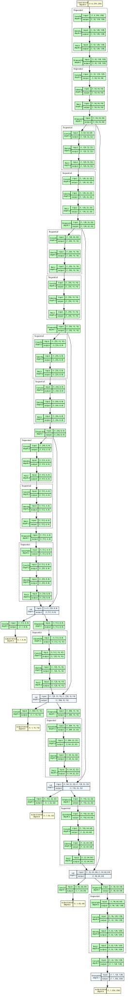

In [10]:
from torchview import draw_graph

model = DepthNet()
model_graph = draw_graph(model, input_size=(1, 6, 256, 256), expand_nested=True, save_graph=True, filename="unet_graph.png")
model_graph.visual_graph 

# Preparing Data for the Model

In [11]:
class RGBDSegDataset(Dataset):
    def __init__(self, rgb_dir, depth_dir, sparse_dir, semseg_dir, file_list, train=True):
        self.rgb_dir = rgb_dir
        self.depth_dir = depth_dir
        self.sparse_dir = sparse_dir
        self.semseg_dir = semseg_dir
        self.file_list = file_list
        self.train = train

        self.to_tensor = transforms.ToTensor()
        self.norm_rgb = transforms.Normalize([0.5]*3, [0.5]*3)  

    def __len__(self):
        return len(self.file_list)

    def __getitem__(self, idx):
        fname = self.file_list[idx]

        rgb = Image.open(os.path.join(self.rgb_dir, fname)).convert('RGB')
        depth = Image.open(os.path.join(self.depth_dir, fname)).convert('L')
        sparse = Image.open(os.path.join(self.sparse_dir, fname)).convert('L')
        semseg = Image.open(os.path.join(self.semseg_dir, fname)).convert('L')

        resize = transforms.Resize((256, 256))
        rgb = resize(rgb)
        depth = resize(depth)
        sparse = resize(sparse)
        semseg = resize(semseg)

        if self.train and random.random() > 0.5:
            rgb = transforms.functional.hflip(rgb)
            depth = transforms.functional.hflip(depth)
            sparse = transforms.functional.hflip(sparse)
            semseg = transforms.functional.hflip(semseg)

        rgb = self.norm_rgb(self.to_tensor(rgb))
        depth = self.to_tensor(depth)
        sparse = self.to_tensor(sparse)
        semseg = self.to_tensor(semseg)  

        return {
            'rgb': rgb,
            'depth': depth,
            'sparse': sparse,
            'semseg': semseg
        }


In [12]:
rgb_dir = "/kaggle/working/nyu_dataset/images"
depth_dir = "/kaggle/working/nyu_dataset/depths"
sparse_dir = "/kaggle/working/nyu_dataset/labels"
semseg_dir = "/kaggle/working/nyu_dataset/instances"

all_filenames = sorted(os.listdir(rgb_dir))
train_filenames = all_filenames[:int(0.9 * len(all_filenames))]
test_filenames = all_filenames[int(0.9 * len(all_filenames)):]

train_dataset = RGBDSegDataset(
    rgb_dir=rgb_dir,
    depth_dir=depth_dir,
    sparse_dir=sparse_dir,
    semseg_dir=semseg_dir,
    file_list=train_filenames,
    train=True
)

test_dataset = RGBDSegDataset(
    rgb_dir=rgb_dir,
    depth_dir=depth_dir,
    sparse_dir=sparse_dir,
    semseg_dir=semseg_dir,
    file_list=test_filenames,
    train=False
)


train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=2)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False, num_workers=2)


In [13]:
def prepare_fixed_input(image_path, depth_path):
   
    resize = transforms.Resize((256, 256))
    to_tensor = transforms.ToTensor()
    normalize = transforms.Normalize([0.5]*3, [0.5]*3)

    img_rgb = Image.open(image_path).convert("RGB")
    img_sparse = Image.open(depth_path).convert("L")

    rgb = normalize(to_tensor(resize(img_rgb))).unsqueeze(0).to(DEVICE)    
    sparse = to_tensor(resize(img_sparse)).unsqueeze(0).to(DEVICE)         
    dummy = torch.zeros((1, 2, 256, 256), device=DEVICE)                      

    input_tensor = torch.cat([rgb, sparse, dummy], dim=1)                     

    return rgb, sparse, input_tensor


# Training

In [14]:
def train_one_epoch(model, dataloader, optimizer, epoch, fixed_input, fixed_rgb, fixed_sparse, criterion=nn.L1Loss()):
    model.train()
    running_loss = 0.0

    for batch_idx, batch in enumerate(tqdm(dataloader, desc=f"Epoch {epoch+1}")):
        rgb = batch['rgb'].to(DEVICE)
        sparse = batch['sparse'].to(DEVICE) 
        depth = batch['depth'].to(DEVICE)     

        B, _, H, W = rgb.shape
        dummy_channels = torch.zeros((B, 2, H, W), device=DEVICE)
        input_tensor = torch.cat([rgb, sparse, dummy_channels], dim=1) 

        optimizer.zero_grad()
        outputs = model(input_tensor)  

        if not isinstance(outputs, (list, tuple)):
            outputs = [outputs]

        loss = 0
        for out in outputs:
            if out.ndim != 4:
                raise ValueError(f"Expected 4D tensor from model output, got {out.shape}")
            gt_resized = F.interpolate(depth, size=out.shape[2:], mode='bilinear', align_corners=False)
            loss += criterion(out, gt_resized)
        loss /= len(outputs)

        loss.backward()
        optimizer.step()
        running_loss += loss.item()

        model.eval()
    with torch.no_grad():
        fixed_input = fixed_input.to(DEVICE)
        pred_vis = model(fixed_input)[0][0].cpu() 
    rgb_vis = fixed_rgb[0].cpu()
    depth_vis = fixed_sparse[0].cpu()

    clear_output(wait=True)
    print(f"Epoch {epoch+1} - Avg Loss: {running_loss / len(dataloader):.4f}")

    fig, axs = plt.subplots(1, 3, figsize=(12, 4))
    rgb_denorm = rgb_vis * 0.5 + 0.5
    axs[0].imshow(TF.to_pil_image(rgb_denorm.clamp(0, 1)))
    axs[0].set_title("Fixed RGB")
    axs[0].axis('off')

    axs[1].imshow(depth_vis.squeeze(0), cmap='plasma')
    axs[1].set_title("Fixed Sparse Depth")
    axs[1].axis('off')

    axs[2].imshow(pred_vis.squeeze(0), cmap='plasma')
    axs[2].set_title("Predicted Depth")
    axs[2].axis('off')

    plt.tight_layout()
    plt.show()

Epoch 200 - Avg Loss: 0.0263


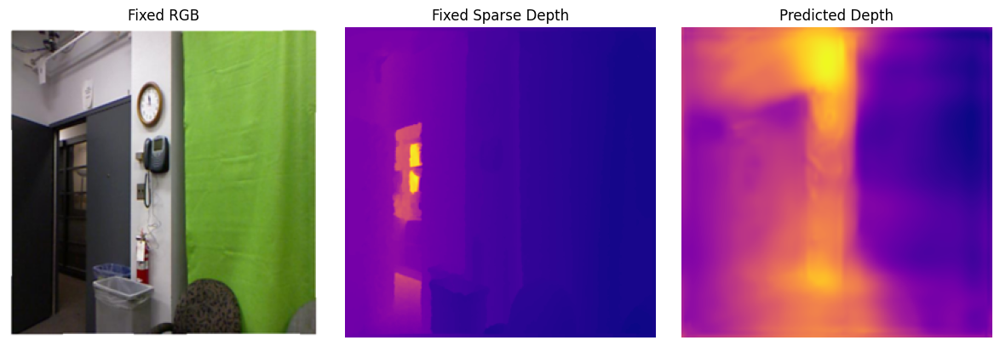

In [15]:
model = DepthNet(batch_norm=True, depth_activation='elu').to(DEVICE)
optimizer = torch.optim.Adam(model.parameters(), lr=LEARNING_RATE)

all_filenames = sorted(os.listdir(rgb_dir))
train_files = all_filenames[:int(0.9 * len(all_filenames))]
test_files = all_filenames[int(0.9 * len(all_filenames)):]

train_dataset = RGBDSegDataset(rgb_dir, depth_dir, sparse_dir, semseg_dir, train_files, train=True)
test_dataset = RGBDSegDataset(rgb_dir, depth_dir, sparse_dir, semseg_dir, test_files, train=False)

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=2)

fixed_rgb, fixed_sparse, fixed_input = prepare_fixed_input(
    image_path="/kaggle/working/nyu_dataset/images/0007.png",
    depth_path="/kaggle/working/nyu_dataset/depths/0007.png"
)

for epoch in range(200):
    train_one_epoch(model, train_loader, optimizer, epoch,
                    fixed_input, fixed_rgb, fixed_sparse)

# Save model
torch.save(model.state_dict(), "depthnet_final.pth")


# Visualize Outputs

In [16]:
def denormalize(tensor, mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5]):
    for t, m, s in zip(tensor, mean, std):
        t.mul_(s).add_(m)
    return tensor

def show_predictions(model, test_loader, device, num_batches=1):
    model.eval()
    model.to(device)

    with torch.no_grad():
        for batch_idx, batch in enumerate(test_loader):
            if batch_idx >= num_batches:
                break

            # Get input data
            rgb = batch['rgb'].to(device)         # [B, 3, H, W]
            sparse = batch['sparse'].to(device)   # [B, 1, H, W]
            depth = batch['depth'].to(device)     # [B, 1, H, W]

            B, _, H, W = rgb.shape
            dummy = torch.zeros((B, 2, H, W), device=device)  # [B, 2, H, W]
            input_tensor = torch.cat([rgb, sparse, dummy], dim=1)  # [B, 6, H, W]

            # Forward pass
            predictions = model(input_tensor)

            # If model returns multi-scale outputs
            if isinstance(predictions, (list, tuple)):
                predictions = predictions[0]  # use the finest scale

            # Move all to CPU for visualization
            rgb = rgb.cpu()
            depth = depth.cpu()
            predictions = predictions.cpu()

            batch_size = rgb.size(0)
            for i in range(batch_size):
                rgb_img = denormalize(rgb[i].clone()).clamp(0, 1)
                rgb_pil = TF.to_pil_image(rgb_img)

                gt_depth = depth[i, 0]
                pred_depth = predictions[i, 0]

                # Plotting
                plt.figure(figsize=(15, 5))
                titles = ['RGB Image', 'Ground Truth Depth', 'Predicted Depth']
                display_list = [rgb_pil, gt_depth, pred_depth]

                for j in range(3):
                    plt.subplot(1, 3, j + 1)
                    plt.title(titles[j])
                    if j == 0:
                        plt.imshow(display_list[j])
                    else:
                        plt.imshow(display_list[j], cmap='plasma')
                    plt.axis('off')
                plt.tight_layout()
                plt.show()

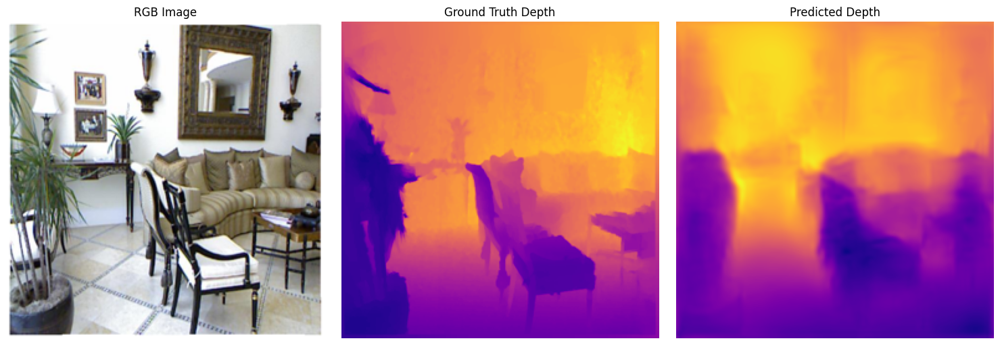

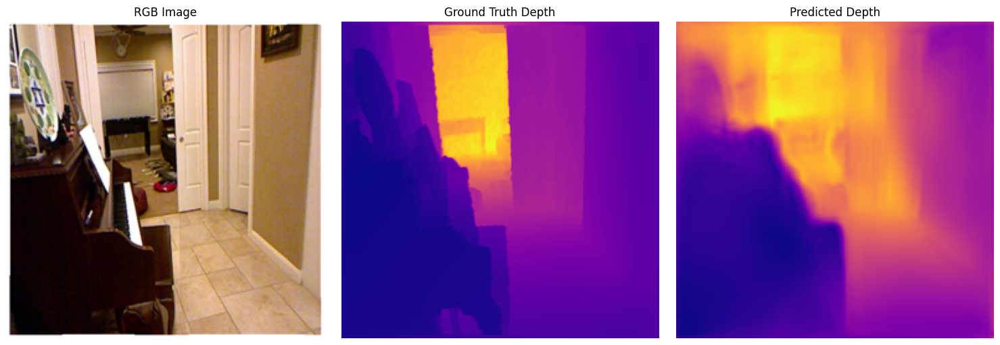

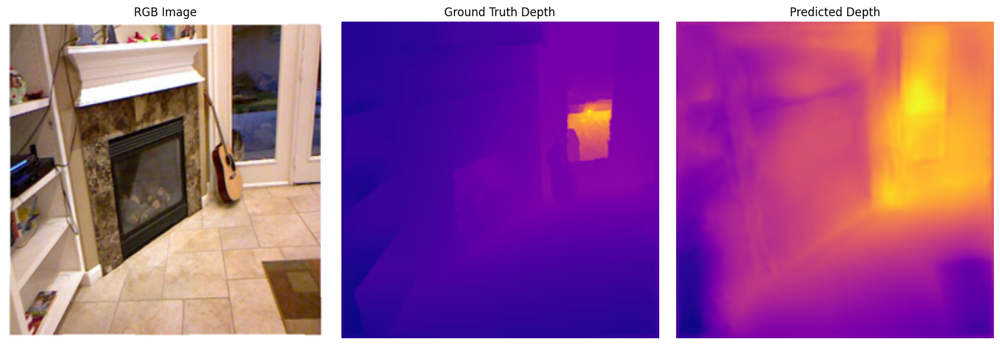

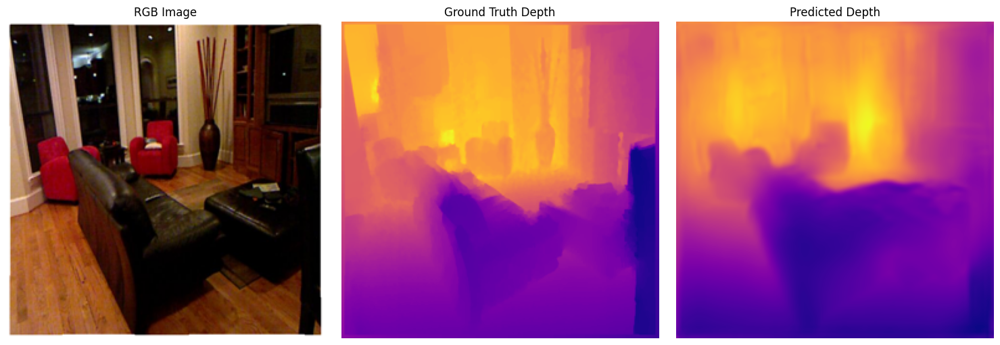

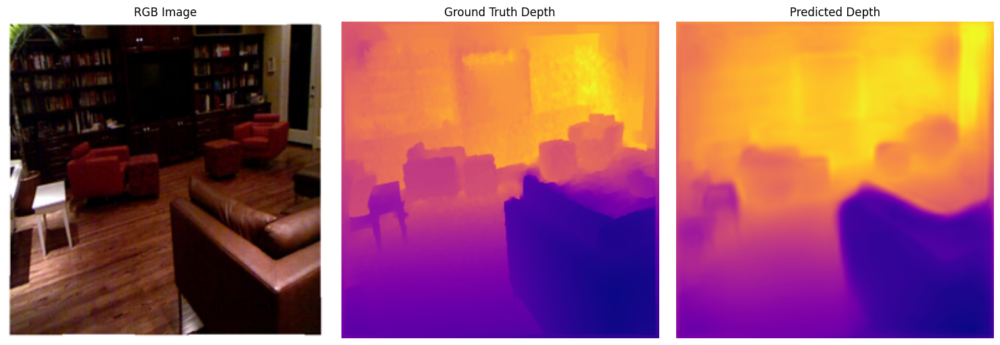

...

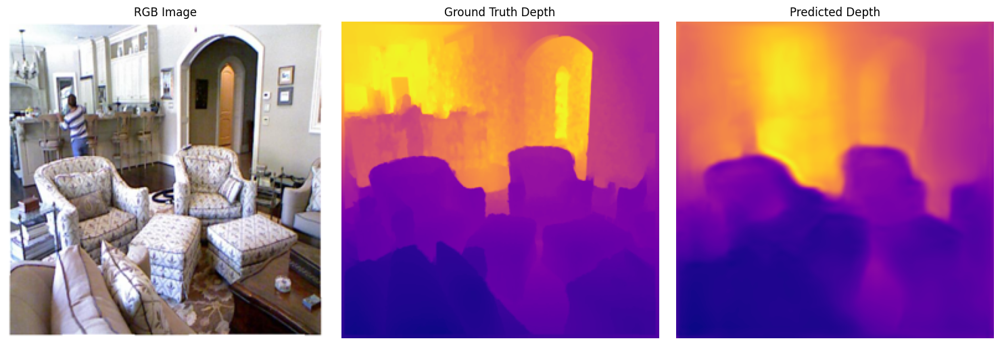

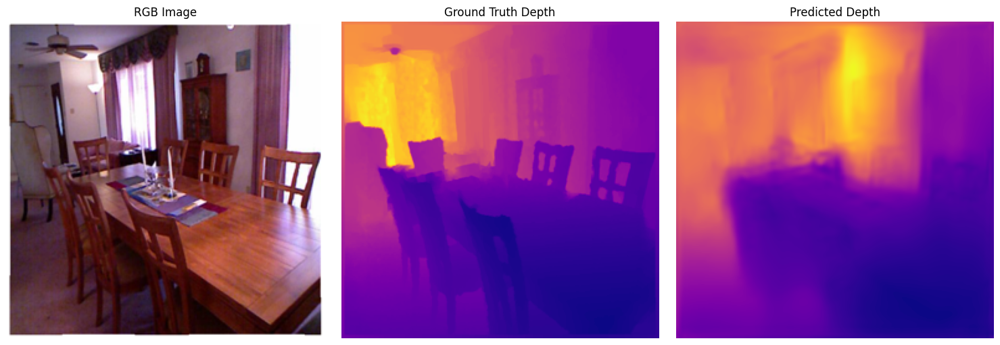

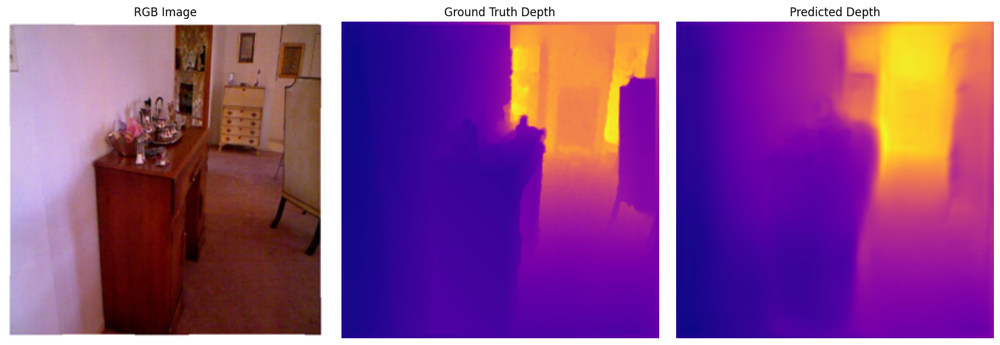

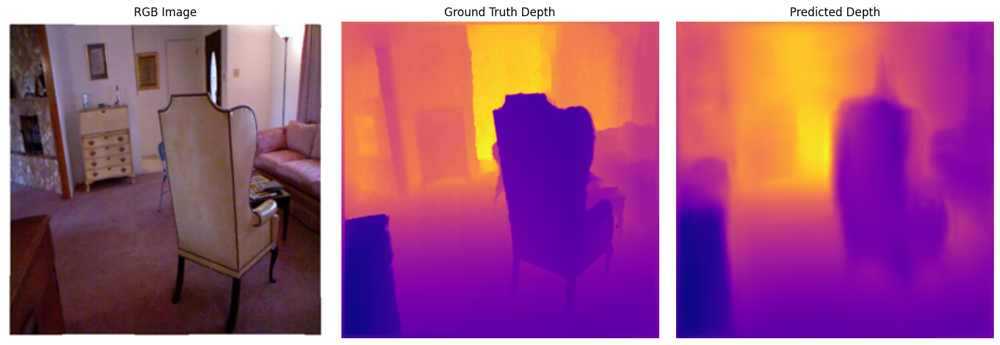

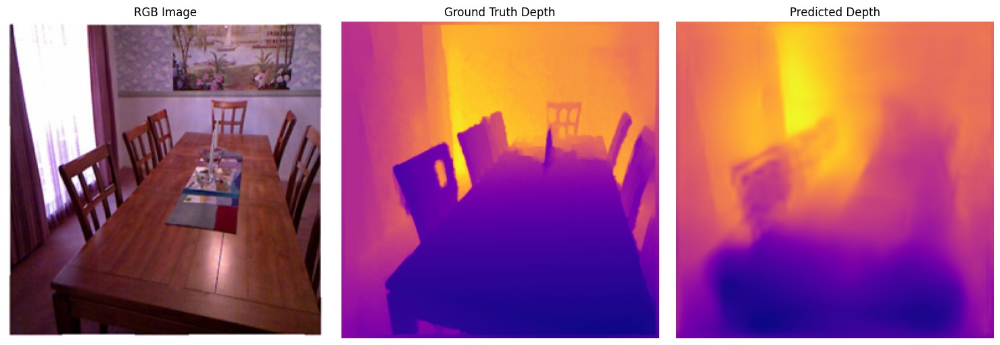

In [17]:
show_predictions(model, test_loader, DEVICE, num_batches=10)